In [1]:
! pip install -U bitsandbytes accelerate
! pip install git+https://github.com/huggingface/transformers

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.4/59.4 MB 29.5 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 375.8/375.8 kB 19.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.6 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 83.8 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 69.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 44.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.9 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 29.7 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.1 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━

In [2]:
from transformers import Qwen3VLForConditionalGeneration, AutoProcessor, BitsAndBytesConfig
# from pydantic import BaseModel, Field
from typing import List, Optional
import torch
import json
from PIL import Image

In [3]:
quantization_config = BitsAndBytesConfig(
    load_in_4bit=True,            # <-- this enables 4-bit quantization
    bnb_4bit_use_double_quant=True,
    bnb_4bit_quant_type="nf4",    # NormalFloat4 quantization (recommended)
    bnb_4bit_compute_dtype="float16"  # good balance between speed & accuracy for T4
)

model_name = "Qwen/Qwen3-VL-8B-Instruct"

model = Qwen3VLForConditionalGeneration.from_pretrained(
    "Qwen/Qwen3-VL-8B-Instruct",
    # dtype="auto",
    device_map="auto",
    quantization_config=quantization_config
)

processor = AutoProcessor.from_pretrained("Qwen/Qwen3-VL-8B-Instruct")

config.json: 0.00B [00:00, ?B/s]

model.safetensors.index.json: 0.00B [00:00, ?B/s]

Fetching 4 files:   0%|          | 0/4 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/4 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/269 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/390 [00:00<?, ?B/s]

tokenizer_config.json: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

video_preprocessor_config.json:   0%|          | 0.00/385 [00:00<?, ?B/s]

chat_template.json: 0.00B [00:00, ?B/s]

In [4]:
def qwen3vl_inference(image_path, prompt):
    
    messages = [
        {
            "role": "user",
            "content": [
                {
                    "type": "image",
                    "image": image_path,
                },
                {"type": "text", "text": prompt},
            ],
        }
    ]
    
    # Preparation for inference
    inputs = processor.apply_chat_template(
        messages,
        tokenize=True,
        add_generation_prompt=True,
        return_dict=True,
        return_tensors="pt"
    )
    inputs = inputs.to(model.device)
    
    # Inference: Generation of the output
    generated_ids = model.generate(**inputs, max_new_tokens=1024)
    generated_ids_trimmed = [
        out_ids[len(in_ids) :] for in_ids, out_ids in zip(inputs.input_ids, generated_ids)
    ]
    output_text = processor.batch_decode(
        generated_ids_trimmed, skip_special_tokens=True, clean_up_tokenization_spaces=False
    )
    for text in output_text:
        print(text)

In [5]:
from IPython.display import display
from PIL import Image
def image_processor_2(input_path: str, output_path: str) -> str:
    from PIL import Image, ImageOps
    import cv2
    import numpy as np
 
    print(f"Process: {input_path}")
 
    # Load image with PIL
    pil_img = Image.open(input_path)
    pil_img = ImageOps.exif_transpose(pil_img)  # fix orientation
 
    # Convert to grayscale OpenCV
    image = cv2.cvtColor(np.array(pil_img), cv2.COLOR_RGB2GRAY)
 
    # 1. Upscale to make small text larger
    scale_factor = 2.0  # try 2x or even 3x
    image = cv2.resize(image, None, fx=scale_factor, fy=scale_factor, interpolation=cv2.INTER_CUBIC)
 
    # 2. Apply CLAHE (adaptive histogram equalization) to improve contrast
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8,8))
    image = clahe.apply(image)
 
    # 3. Optional light denoising (skip heavy Gaussian blur!)
    image = cv2.medianBlur(image, 3)
 
    # 4. Adaptive thresholding to make text crisp
    thresh = cv2.adaptiveThreshold(
        image, 255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY,
        31, 15
    )
 
    # 5. Sharpen edges a bit
    kernel = np.array([[0,-1,0], [-1,5,-1], [0,-1,0]])
    sharpened = cv2.filter2D(thresh, -1, kernel)
 
    # Save result
    result = Image.fromarray(sharpened)
    # result.save(prefix_data_dir(output_path, False))
    result.save(output_path)

    image = Image.open(output_path)

    display(image)
 
 
    return output_path

In [6]:
def resize_image(image_path, height, width):
    new_size = (height, width)
    image = Image.open(image_path)
    resized_image = image.resize(new_size, Image.LANCZOS)
    return resized_image 

Process: /kaggle/input/psc-forms/20250407_150848.jpg


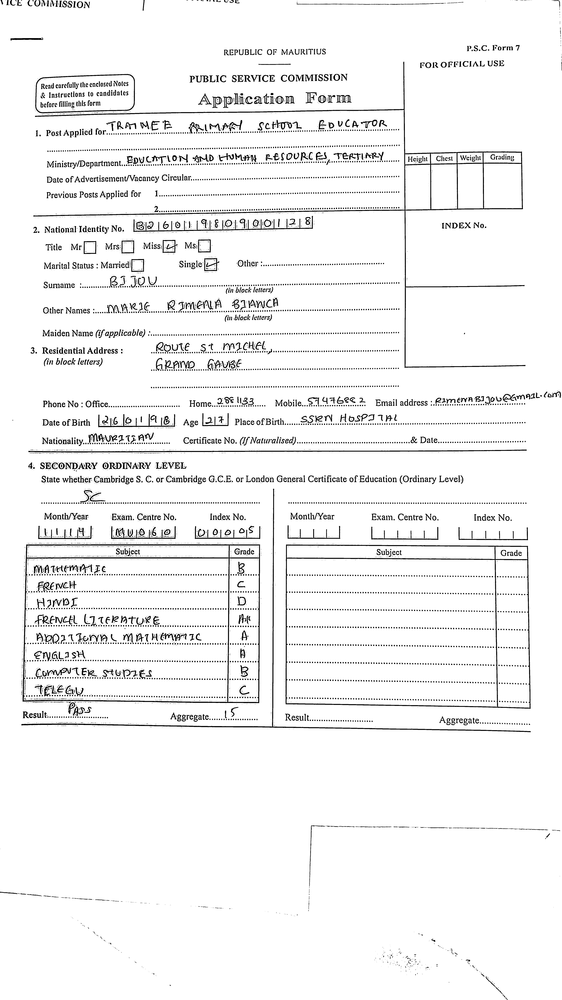

In [29]:
input_img = "/kaggle/input/psc-forms/20250407_150848.jpg"
output_img = "/kaggle/working/processed_150848.jpg"
preprocessed_img_path = image_processor_2(input_img, output_img)
output_image = Image.open(preprocessed_img_path)

Process: /kaggle/input/psc-forms/20251111_160053.jpg


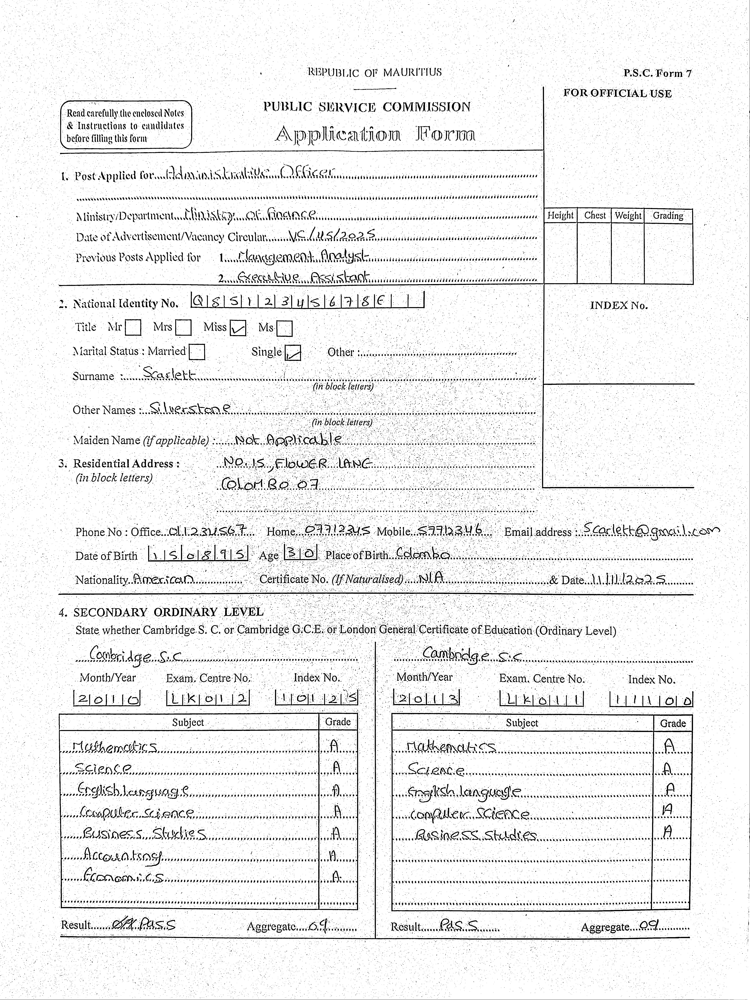

In [7]:
input_img = "/kaggle/input/psc-forms/20251111_160053.jpg"
output_img = "/kaggle/working/processed_20251111_160053.jpg"
preprocessed_img_path = image_processor_2(input_img, output_img)
output_image = Image.open(preprocessed_img_path)

In [8]:
final_image = resize_image(preprocessed_img_path, 1024, 1024)

prompt = """Extract all visible text and structured content from this image or PDF.
                Preserve the original structure as closely as possible — including headings, paragraphs, lists, tables, and emphasis — and output everything in valid Markdown.
                Guidelines: Keep text order consistent with the visual layout (top to bottom, left to right).
                Convert any bold, italic, or underlined text to Markdown equivalents (bold, italic, underline).
                For tables, use Markdown table syntax. For bullet or numbered lists, preserve indentation and order.
                If there are images, diagrams, or logos, include a Markdown placeholder like ![image: description].
                Do not omit any textual element, even if faint or partially visible.
                If handwriting~ or unclear text appears, write [unreadable] or your best guess in brackets.
                Output only the Markdown — no explanations or comments."""

qwen3vl_inference(final_image, prompt)

```markdown
REPUBLIC OF MAURITIUS

PUBLIC SERVICE COMMISSION
Application Form

P.S.C. Form 7
FOR OFFICIAL USE

Read carefully the enclosed Notes
& Instructions to candidates
before filling this form

1. Post Applied for... **Assistant Officer**
Ministry/Department... **Ministry of Finance**
Date of Advertisement/Vacancy Circular... **15/05/2025**
Previous Posts Applied for
1. **Management Analyst**
2. **Executive Assistant**

2. National Identity No. **Q1S1S1231YK678E11**

Title Mr ☐ Mrs ☐ Miss ☑ Ms ☐
Marital Status : Married ☐ Single ☑ Other : 
Surname : **Scarlett** (in block letters)
Other Names : **Silverstone** (in block letters)
Maiden Name (if applicable) : **Not Applicable**

3. Residential Address :
**NO.15, FLOWER LANE**
**COLORADO ST** (in block letters)
Phone No. : Office... **01234567** Home... **07712345** Mobile... **07712345** Email address : **Scarlett@gmail.com**
Date of Birth **11/01/1993** Age **21** Place of Birth **Colombo**
Nationality **American** Certificate No

In [9]:
torch.cuda.empty_cache()

In [18]:
final_image = resize_image(output_img, 1920, 1920)

prompt = "Output only the Markdown — no explanations or comments."

qwen3vl_inference(final_image, prompt)

```markdown
# PUBLIC SERVICE COMMISSION
Application Form

---

## 1. Post Applied for
**TRAINED PRIMARY SCHOOL EDUCATOR**

Ministry/Department: EDUCATION AND HUMAN RESOURCES, TERTIARY

Date of Advertisement/Vacancy Circular: …………………………………………

Previous Posts Applied for
1. …………………………………………
2. …………………………………………

---

## 2. National Identity No.
**82601980900128**

Title: Mr ☐ Mrs ☐ Miss ☐ Ms ☐

Marital Status: Married ☐ Single ☐ Other: …………………………………………

Surname: **BIJOU** (in block letters)

Other Names: **MARIE RIMENA BIANCA** (in block letters)

Maiden Name (if applicable): …………………………………………

---

## 3. Residential Address
(in block letters)
**ROUTE ST MICHEL, GRAND GAUGE**

Phone No: Office …………………… Home 2561133 …………………… Mobile 747682 …………………… Email address: **rimena.bijou@gmail.com**

Date of Birth: **26/01/198** Age **27** Place of Birth: **SSRN HOSPITAL**

Nationality: **MAURITIAN** Certificate No. (If Naturalised) …………………… & Date ……………………

---

## 4. SECONDARY ORDINARY LEVEL

State 

In [10]:
test_image = '/kaggle/input/psc-forms/20251111_160053.jpg'
final_image = resize_image(test_image, 1024, 1024)

prompt = """Extract all visible text and structured content from this image or PDF.
                Preserve the original structure as closely as possible — including headings, paragraphs, lists, tables, and emphasis — and output everything in valid Markdown.
                Guidelines: Keep text order consistent with the visual layout (top to bottom, left to right).
                Convert any bold, italic, or underlined text to Markdown equivalents (bold, italic, underline).
                For tables, use Markdown table syntax. For bullet or numbered lists, preserve indentation and order.
                If there are images, diagrams, or logos, include a Markdown placeholder like ![image: description].
                Do not omit any textual element, even if faint or partially visible.
                If handwriting~ or unclear text appears, write [unreadable] or your best guess in brackets.
                Output only the Markdown — no explanations or comments."""

qwen3vl_inference(final_image, prompt)

```markdown
REPUBLIC OF MAURITIUS

P.S.C. Form 7

FOR OFFICIAL USE

PUBLIC SERVICE COMMISSION

Application Form

Read carefully the enclosed Notes & Instructions to candidates before filling this form

1. Post Applied for. Administrative Officer

Ministry/Department. Ministry of Finance

Date of Advertisement/Vacancy Circular. 05/05/2025

Previous Posts Applied for

1. Management Analyst

2. Executive Assistant

2. National Identity No. 08151123456789C

Title Mr ☐ Mrs ☐ Miss ☑ Ms ☐

Marital Status: Married ☐ Single ☑ Other: 

Surname: Scarlett

Other Names: Silverstone

Maiden Name (if applicable): Not Applicable

3. Residential Address:

NO.15, FLOWER LANE

COLONBO C7

Phone No: Office... 01234567. Home... 07712345. Mobile... 07712346. Email address: Scarlett@gmail.com

Date of Birth 11/05/1995. Age 30. Place of Birth...Colombo.

Nationality. American. Certificate No. (if Naturalised)...N/A & Date. 11/11/2025.

4. SECONDARY ORDINARY LEVEL

State whether Cambridge S.C. or Cambridge G.C

In [11]:
Extract all visible text and structured content from this image or PDF.
Do not omit any textual element, even if faint or partially visible.
If handwriting~ or unclear text appears, write [unreadable] or your best guess in brackets.

                    {

  "$schema": "https://json-schema.org/draft/2020-12/schema",

  "title": "PSCApplication",

  "type": "object",

  "properties": {

    "post_applied_for": { "type": "string" },

    "ministry_department": { "type": "string" },

    "date_of_advertisement": { "type": "string", "format": "date" },

    "national_identity_no": { "type": "string" },

    "surname": { "type": "string" },

    "other_names": { "type": "string" },

    "residential_address": { "type": "string" },

    "date_of_birth": { "type": "string", "format": "date" },

    "age": { "type": "integer" },

    "place_of_birth": { "type": "string" },

    "nationality": { "type": "string" },

    "phone_mobile": { "type": "string" },

    "email": { "type": "string", "format": "email" },
 
    "degree_qualifications": {

      "type": "array",

      "items": {

        "type": "object",

        "properties": {

          "level": { "type": "string" },

          "institution": { "type": "string" },

          "country": { "type": "string" },

          "qualification_name": { "type": "string" },

          "class_division_level": { "type": "string" },

          "date_of_result": { "type": "string", "format": "date" },

          "course_type": { "type": "string" },

          "duration_from": { "type": "string", "format": "date" },

          "duration_to": { "type": "string", "format": "date" }

        },

        "required": [

          "level", "institution", "country", "qualification_name",

          "class_division_level", "date_of_result", "course_type",

          "duration_from", "duration_to"

        ]

      }

    },
 
    "diploma_qualifications": {

      "type": "array",

      "items": {

        "type": "object",

        "properties": {

          "level": { "type": "string" },

          "institution": { "type": "string" },

          "country": { "type": "string" },

          "qualification_name": { "type": "string" },

          "class_division_level": { "type": "string" },

          "date_of_result": { "type": "string", "format": "date" },

          "course_type": { "type": "string" },

          "duration_from": { "type": "string", "format": "date" },

          "duration_to": { "type": "string", "format": "date" }

        },

        "required": [

          "level", "institution", "country", "qualification_name",

          "class_division_level", "date_of_result", "course_type",

          "duration_from", "duration_to"

        ]

      }

    },
 
    "ordinary_level_exams": {

      "type": "array",

      "items": {

        "type": "object",

        "properties": {

          "exam_type": { "type": "string" },

          "month_year": { "type": "string" },

          "index_no": { "type": "string" },

          "exam_centre_no": { "type": "string" },

          "subjects": {

            "type": "array",

            "items": {

              "type": "object",

              "properties": {

                "subject": { "type": "string" },

                "grade": { "type": "string" }

              },

              "required": ["subject", "grade"]

            }

          },

          "result": { "type": "string" },

          "aggregate": { "type": "string" }

        },

        "required": [

          "exam_type", "month_year", "index_no",

          "exam_centre_no", "subjects", "result", "aggregate"

        ]

      }

    },
 
    "advanced_level_exams": {

      "type": "array",

      "items": {

        "type": "object",

        "properties": {

          "exam_type": { "type": "string" },

          "month_year": { "type": "string" },

          "index_no": { "type": "string" },

          "exam_centre_no": { "type": "string" },

          "subjects": {

            "type": "array",

            "items": {

              "type": "object",

              "properties": {

                "subject": { "type": "string" },

                "grade": { "type": "string" },

                "level": { "type": "string" }

              },

              "required": ["subject", "grade", "level"]

            }

          },

          "result": { "type": "string" },

          "aggregate": { "type": "string" }

        },

        "required": [

          "exam_type", "month_year", "index_no",

          "exam_centre_no", "subjects", "result", "aggregate"

        ]

      }

    },
 
    "current_government_employment": {

      "type": "object",

      "properties": {

        "post_held": { "type": "string" },

        "temporary_substantive": { "type": "string" },

        "ministry_department": { "type": "string" },

        "date_of_appointment": { "type": "string", "format": "date" },

        "date_of_confirmation": { "type": "string", "format": "date" },

        "present_salary": { "type": "number" }

      },

      "required": [

        "post_held", "temporary_substantive", "ministry_department",

        "date_of_appointment", "date_of_confirmation", "present_salary"

      ]

    },
 
    "other_employment": {

      "type": "array",

      "items": {

        "type": "object",

        "properties": {

          "post_held": { "type": "string" },

          "ministry_department": { "type": "string" },

          "date_of_appointment": { "type": "string", "format": "date" },

          "present_salary": { "type": "number" }

        },

        "required": ["post_held", "ministry_department", "date_of_appointment", "present_salary"]

      }

    },
 
    "investigation_enquiry": { "type": "boolean" },

    "investigation_details": { "type": ["string", "null"] },

    "court_conviction": { "type": "boolean" },

    "conviction_details": { "type": ["string", "null"] },

    "resigned_retired_dismissed": { "type": "boolean" },

    "resignation_details": { "type": ["string", "null"] },
 
    "other_qualifications": {

      "type": "array",

      "items": { "type": "string" }

    }

  },

  "required": [

    "post_applied_for",

    "ministry_department",

    "date_of_advertisement",

    "national_identity_no",

    "surname",

    "other_names",

    "residential_address",

    "date_of_birth",

    "age",

    "place_of_birth",

    "nationality",

    "phone_mobile",

    "email"

  ]

}

 

SyntaxError: invalid syntax (1242778451.py, line 1)